# Домашнее задание 1

**Выполнил:** Тяжова Наталья Андреевна

**На сколько выполнил:** 9.6

**Правила игры:**

* возле каждой задачи указано число баллов (в сококупности можно получить 10 баллов)

* дополнительные задачи выделены звездочкой (также указано число баллов). Данные баллы можно будет использовать для улучшения результата за любое домашнее задание

* все подсчеты необходимо делать с помощью pandas-numpy (использовать как можно меньше циклов, за использование циклов, где это не требуются, будем штрафовать)

* для визуализации можно использовать matplotlib-seaborn-plotly (учтите, что все графики должны выглядеть опрятно, иметь название-подписи, за нечитабельные графики будем штрафовать)

* возможно, что в данных есть пустоты и невалидные значения. Перед началом любой работы необходимо исследовать, и если такие есть, убрать их

* соблюдайте чистоту кода: переменные должны быть осмысленными, не повторяйтесь, если в этом нет необходимости (иначе используйте функции). Чем чище код - тем проще нам поставить вам хорошую оценку :)

* общая рекомендация: на вопросы со звездочкой отвечать в самом конце, возможно, будет проще)

## Данные 

В этом домашнем задании вам придется оказаться на месте аналитика в бразильском маркетплейсе [Olist](https://olist.com/pt-br/). Вам необходимо исследовать данные и на их основании сделать выводы, которые помогут бизнесу расцветать!

Данные находятся тут: (будет ссылка)

Ван дано 9 датасетов, которые содержат в себе все данные по 100 000 заказам со всей Бразилии. Чтобы облегчить вам жизнь, вот связи по этим датасетам (файл product_category_name_translation является переводом названий категорий с португальского на английский)

![](https://i.imgur.com/HRhd2Y0.png)

Ну что же, начнем, пожалуй!

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px
from copy import deepcopy 
import datetime

!wget https://github.com/Palladain/Deep_Python/raw/main/Homeworks/Homework_1/archive.zip
!unzip archive.zip


--2022-10-16 15:31:15--  https://github.com/Palladain/Deep_Python/raw/main/Homeworks/Homework_1/archive.zip
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Palladain/Deep_Python/main/Homeworks/Homework_1/archive.zip [following]
--2022-10-16 15:31:15--  https://raw.githubusercontent.com/Palladain/Deep_Python/main/Homeworks/Homework_1/archive.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 44717580 (43M) [application/zip]
Saving to: ‘archive.zip.1’

archive.zip.1       100%[===================>]  42.65M   198MB/s    in 0.2s    

2022-10-16 15:31:16 (198 MB/s) - ‘archive.zip.1’ saved [44717580/

**Data Preparation:**

In [ ]:
products = pd.read_csv('olist_products_dataset.csv')
products.rename({"product_description_lenght" : "product_description_length", "product_name_lenght" : "product_name_length"}, axis=1, inplace=True)
print(products.columns)

products_without_nan = products.dropna(axis=1)
print(products_without_nan.columns)
#Видим, что none есть во всех столбцах, кроме product_id. При этом, если в строке есть None для столбца, который никак не участвует в дальнейшем анализе данных (например, вес товара), его можно оставить.
#Так и сделаем:
products.dropna(axis=0, subset=["product_category_name", "product_name_length", "product_description_length", "product_photos_qty"], inplace=True)


Index(['product_id', 'product_category_name', 'product_name_length',
       'product_description_length', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm'],
      dtype='object')
Index(['product_id'], dtype='object')


In [ ]:
order_items = pd.read_csv('olist_order_items_dataset.csv')
print(order_items.columns)

order_items_without_nan = order_items.dropna(axis=1)
print(order_items_without_nan.columns)
#В таблице нет nan => ничего не удаляем

Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')
Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')


In [ ]:
translation = pd.read_csv('product_category_name_translation.csv')
print(translation.columns)

translation_without_nan = translation.dropna(axis=1)
print(translation_without_nan.columns)


Index(['product_category_name', 'product_category_name_english'], dtype='object')
Index(['product_category_name', 'product_category_name_english'], dtype='object')


In [ ]:
sellers = pd.read_csv('olist_sellers_dataset.csv')
print(sellers.columns)

sellers_without_nan = sellers.dropna(axis=1)
print(sellers_without_nan.columns)


Index(['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_state'], dtype='object')
Index(['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_state'], dtype='object')


In [ ]:
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
print(geolocation.columns)

geolocation_without_nan = geolocation.dropna(axis=1)
print(geolocation_without_nan.columns)

Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_state'],
      dtype='object')
Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_state'],
      dtype='object')


In [ ]:
orders = pd.read_csv('olist_orders_dataset.csv')
print(orders.columns)

orders_without_nan = orders.dropna(axis=1)
print(orders_without_nan.columns)

orders.dropna(subset=["order_delivered_customer_date"], inplace=True)

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')
Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_estimated_delivery_date'],
      dtype='object')


In [ ]:
customers = pd.read_csv('olist_customers_dataset.csv')
print(customers.columns)

customers_without_nan = customers.dropna(axis=1)
print(customers_without_nan.columns)

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')
Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')


In [ ]:
payments = pd.read_csv('olist_order_payments_dataset.csv')
print(payments.columns)

payments_without_nan = payments.dropna(axis=1)
print(payments_without_nan.columns)

payments = payments[lambda row: row["payment_type"] != "not_defined"]

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')
Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')


In [ ]:
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
print(order_reviews.columns)

order_reviews_without_nan = order_reviews.dropna(axis=1)
print(order_reviews_without_nan.columns)
#NaN есть только в тех столбцах, которые мы не используем => не удаляем их

Index(['review_id', 'order_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp'],
      dtype='object')
Index(['review_id', 'order_id', 'review_score', 'review_creation_date',
       'review_answer_timestamp'],
      dtype='object')


## Задание 1 (0.4 балла)

Определите:

* Число товаров
* Среднюю стоимость товара

в разрезе категорий (все категории должны быть на английском языке)

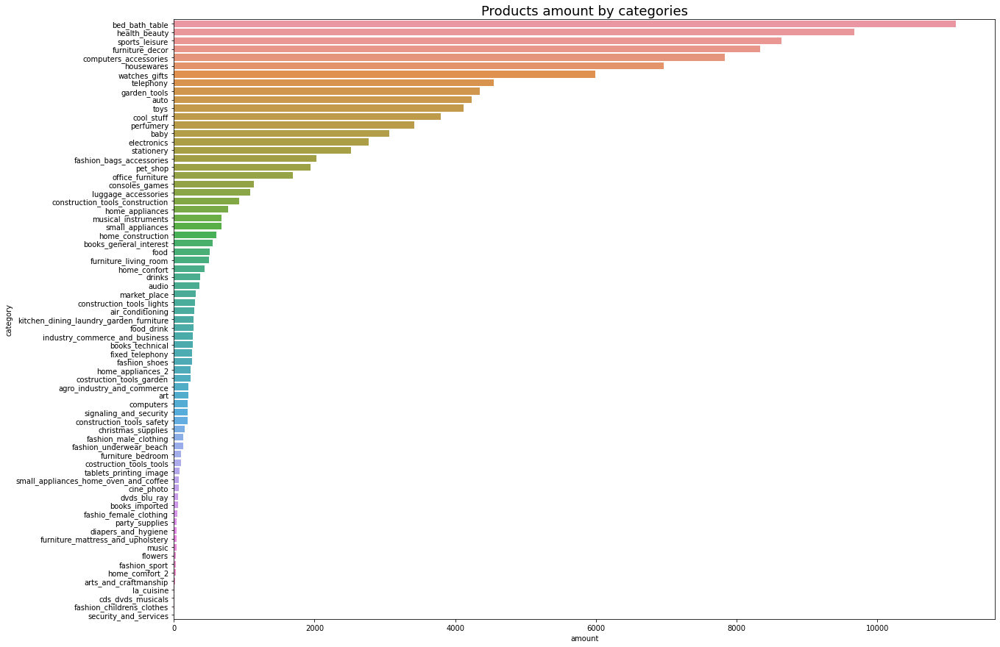

In [ ]:
products_prices = pd.merge(pd.merge(products, order_items[["price", "product_id"]], how="inner", on="product_id"), translation, how='outer', on='product_category_name')
products_prices_grp = products_prices.groupby('product_category_name_english').agg({"product_id" : "count", "price" : "mean"}).reset_index()
products_prices_grp.rename({"product_id" : "amount", "product_category_name_english" : "category"}, axis=1, inplace=True)

category_amount = products_prices_grp.sort_values(by="amount", ascending=False)

plt.figure(figsize=(20, 15))
sns.barplot(data=category_amount,
            x="amount",
            y="category")
plt.title("Products amount by categories", fontsize=18)
plt.show()


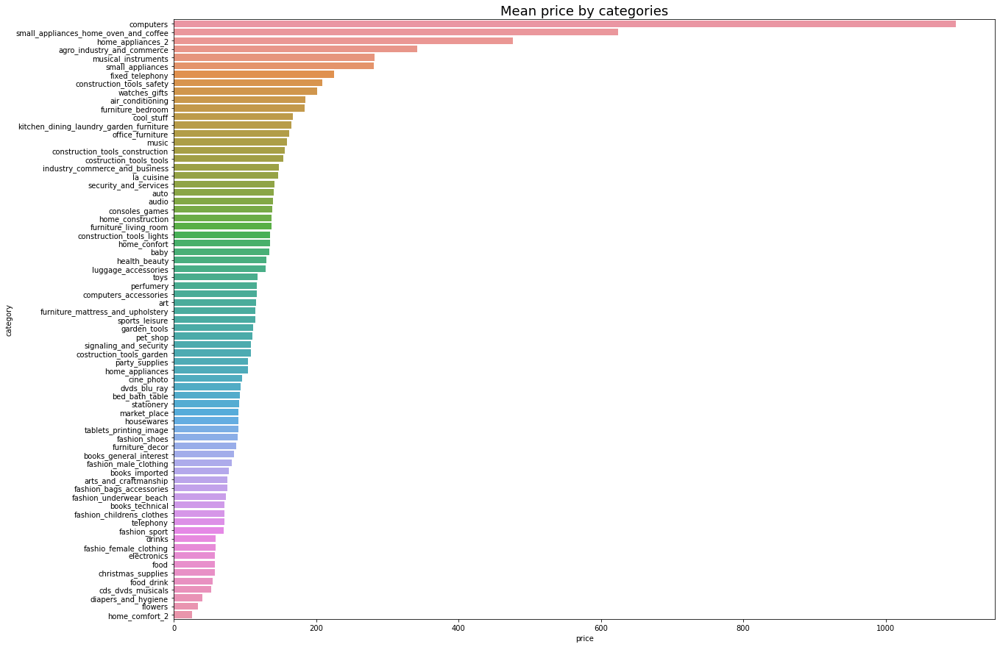

In [ ]:
category_price = products_prices_grp.sort_values(by="price", ascending=False)

plt.figure(figsize=(20, 15))
sns.barplot(data=category_price,
            x="price",
            y="category")
plt.title("Mean price by categories", fontsize=18)
plt.show()

## Задание 2 (1,5 балла)

Определите для каждого продавца основную категорию их продаж.

Отобразите категории по числу продавцов, для которых данная категория основная, а также создайте график, по которому можно выбрать отдельно штат и посмотреть такое же распределение



In [ ]:
main_category_sellers = products_prices.merge(order_items[["seller_id", "product_id"]], how="inner", on="product_id")
main_category_sellers_grp = main_category_sellers.groupby(["seller_id", "product_category_name_english"]).agg({"product_category_name":"count"}).reset_index()
main_category_sellers_grp.rename({"product_category_name" : "amount"}, axis=1, inplace=True)

maxes = main_category_sellers_grp.groupby("seller_id").agg({"amount" : "max"}).reset_index()
maxes.rename({"amount" : "max"}, axis=1, inplace=True)
main_category_sellers_grp = main_category_sellers_grp.merge(maxes, on='seller_id')

main_category_sellers_grp["main_category"] = main_category_sellers_grp.apply(lambda row : row["product_category_name_english"] if row["amount"] == row["max"] else None, axis=1)

main_category_sellers_grp.dropna(inplace=True)
main_category_sellers_grp.drop_duplicates("seller_id", inplace=True)

main_category_sellers =  main_category_sellers_grp[["seller_id", "main_category"]]
main_category_sellers



(6352, 5)
(3104, 5)


,seller_id,main_category
0,0015a82c2db000af6aaaf3ae2ecb0532,small_appliances
2,001cca7ae9ae17fb1caed9dfb1094831,garden_tools
3,001e6ad469a905060d959994f1b41e4f,sports_leisure
4,002100f778ceb8431b7a1020ff7ab48f,furniture_decor
5,004c9cd9d87a3c30c522c48c4fc07416,bed_bath_table
...,...,...
6339,ffcfefa19b08742c5d315f2791395ee5,books_general_interest
6341,ffdd9f82b9a447f6f8d4b91554cc7dd3,housewares
6342,ffeee66ac5d5a62fe688b9d26f83f534,home_appliances
6345,fffd5413c0700ac820c7069d66d98c89,housewares


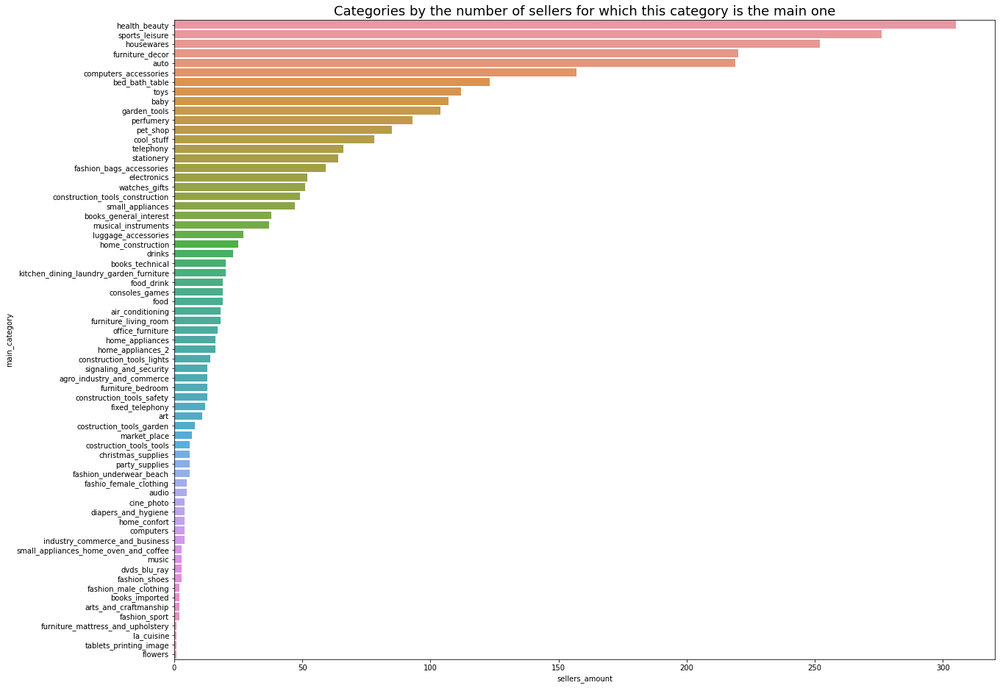

In [ ]:
sellers_main_category = main_category_sellers.groupby("main_category").agg({"seller_id" : "count"}).reset_index()
sellers_main_category.rename({"seller_id" : "sellers_amount"}, axis=1, inplace=True)
sellers_main_category.sort_values(by="sellers_amount", ascending=False, inplace=True)

plt.figure(figsize=(20, 16))
sns.barplot(data=sellers_main_category,
            x="sellers_amount",
            y="main_category") 
plt.title("Categories by the number of sellers for which this category is the main one", fontsize=18)
plt.show()

In [ ]:
states = pd.unique(sellers["seller_state"])

fig = go.Figure()

main_category_sellers_states = main_category_sellers.merge(sellers[["seller_state", "seller_id"]],  how='left', on='seller_id')

for col in states:
  category_in_state = main_category_sellers_states[lambda row: row["seller_state"] == col]
  category_in_state_grp = category_in_state.groupby("main_category").agg({"seller_id" : "count"}).reset_index()
  category_in_state_grp.rename({"seller_id" : "sellers_amount"}, axis=1, inplace=True)
  category_in_state_grp.sort_values(by="sellers_amount", ascending=False, inplace=True)
  fig.add_trace(go.Bar(x=category_in_state_grp["main_category"], y=category_in_state_grp["sellers_amount"], visible=True, opacity=0.6))

buttons = []
updatemenu = [dict()]

for i, col in enumerate(states):
    visibles = [False] * len(states)
    visibles[i] = True
    buttons.append(dict(method='restyle',
                        label=col,
                        args=["visible", visibles]
                        ))
    
updatemenu[0]['buttons']=buttons
updatemenu[0]['direction']='down'
updatemenu[0]['showactive']=True

fig.update_layout(showlegend=False, updatemenus = updatemenu)
fig.update_layout(
    title = {
        "text": "Main categories distribution by states",
        "x": 0.5,
        "font" : {"size" : 18}
    },
    xaxis_title = 'main category',
    yaxis_title = 'sellers amount')

fig.show()

## Задание 3 (1,5 балл)

Покажите процент

* суммы покупок в деньгах

* суммы покупок в штуках

по категории для доставленных заказов, а также разбивку по штатам

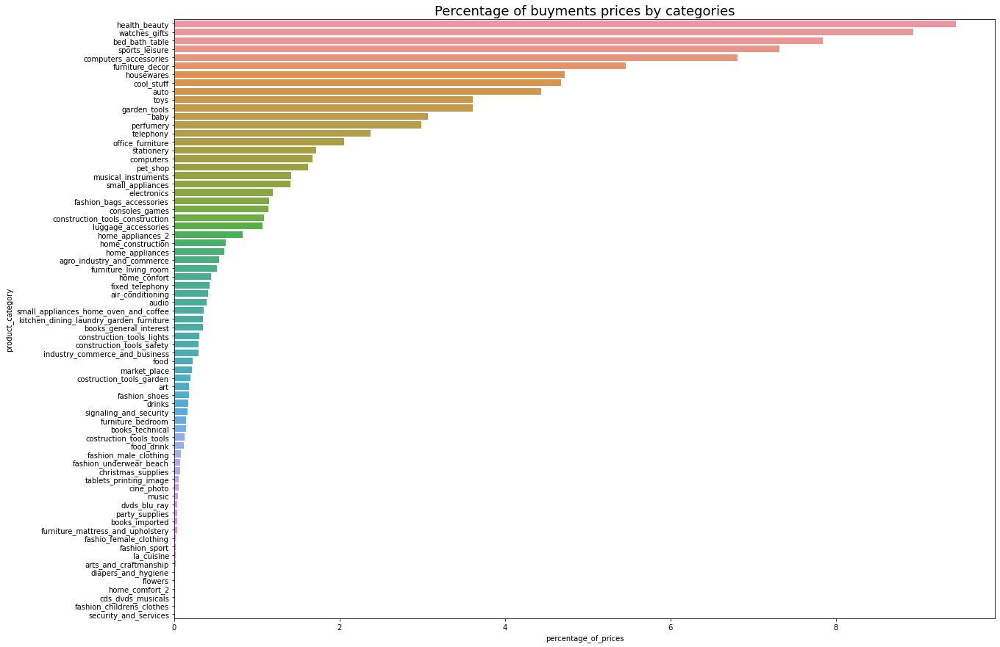

In [ ]:
sums = products[["product_category_name", "product_id"]].merge(
        order_items[["price", "product_id", "seller_id", "order_id"]], how="inner", on="product_id").merge(
        translation, how='outer', on='product_category_name').merge(
        sellers[["seller_id", "seller_state"]], how='inner', on='seller_id').merge(
        orders[["order_id", "order_status", "customer_id"]], how='inner', on='order_id').merge(
        customers[["customer_id", "customer_state"]], how='inner', on='customer_id')

sums.drop(["seller_id", "order_id", "product_category_name", "customer_id"], axis=1, inplace=True)
sums.rename({"product_category_name_english" : "product_category"}, axis=1, inplace=True)
sums_delivered = sums[lambda row: row["order_status"] == 'delivered']

overall_sum = sum(sums_delivered.price)
overall_amount = len(sums_delivered)

sum_by_categories = sums_delivered.groupby("product_category").agg({"price" : lambda x : (sum(x) / overall_sum) * 100}).reset_index().rename({"price" : "percentage_of_prices"}, axis=1)
sum_by_categories.sort_values(by="percentage_of_prices", ascending=False, inplace=True)


plt.figure(figsize=(20, 15))
sns.barplot(data=sum_by_categories,
            x="percentage_of_prices",
            y="product_category") 
plt.title("Percentage of buyments prices by categories", fontsize=18)
plt.show()

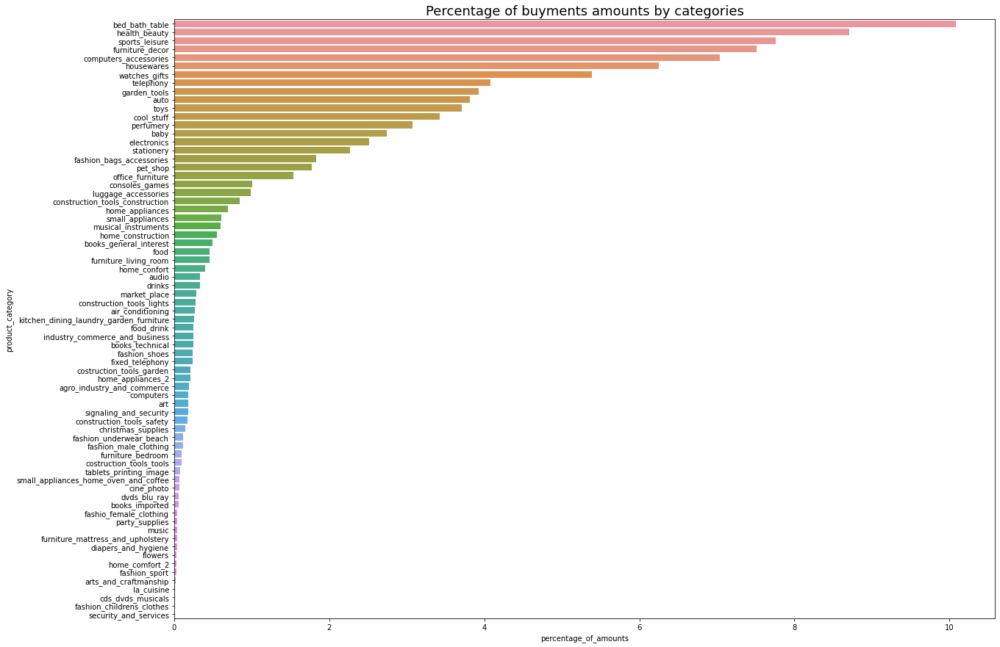

In [ ]:
amount_by_categories = sums_delivered.groupby("product_category").agg({"product_id" : "count"}).reset_index()
amount_by_categories.rename({"product_id" : "count"}, axis=1, inplace=True)
amount_by_categories["percentage_of_amounts"] = amount_by_categories.apply(lambda row: (row["count"] / overall_amount) * 100, axis=1)
amount_by_categories.drop("count", axis=1, inplace=True)
amount_by_categories.sort_values(by="percentage_of_amounts", ascending=False, inplace=True)

plt.figure(figsize=(20, 15))
sns.barplot(data=amount_by_categories,
            x="percentage_of_amounts",
            y="product_category") 
plt.title("Percentage of buyments amounts by categories", fontsize=18)
plt.show()

In [ ]:
cols = pd.unique(sums["customer_state"])

fig = go.Figure()

for col in cols:
    sum_in_state = sums_delivered[lambda row: row["customer_state"] == col]
    overall_sum_in_state = sum((sum_in_state).price)
    sum_by_categories_in_state = sum_in_state.groupby("product_category").agg({"price": lambda x: (sum(x) / overall_sum_in_state) * 100}).reset_index()
    sum_by_categories_in_state.sort_values(by="price", ascending=False, inplace=True)
    fig.add_trace(
        go.Bar(x=sum_by_categories_in_state["product_category"], y=sum_by_categories_in_state["price"], visible=True,opacity=0.6))

buttons = []
updatemenu = [dict()]

for i, col in enumerate(cols):
    visibles = [False] * len(cols)
    visibles[i] = True
    buttons.append(dict(method='restyle',
                        label=col,
                        args=["visible", visibles]
                        ))

updatemenu[0]['buttons'] = buttons
updatemenu[0]['direction'] = 'down'
updatemenu[0]['showactive'] = True

fig.update_layout(showlegend=False, updatemenus=updatemenu)
fig.update_layout(
    title={
        "text": "Buyments prices percentages by categories distribution by states",
        "x": 0.5,
        "font" : {"size" : 18}
    },
    xaxis_title = 'product category',
    yaxis_title = 'buyments price percentage')

fig.show()

In [ ]:
cols = pd.unique(sums["customer_state"])

fig = go.Figure()

for col in cols:
    amount_in_state = sums_delivered[lambda row: row["customer_state"] == col]
    overall_amount_in_state = len(amount_in_state)

    amount_by_categories_in_state = amount_in_state.groupby("product_category").agg({"product_id": "count"}).reset_index()
    amount_by_categories_in_state.rename({"product_id": "count"}, axis=1, inplace=True)
    amount_by_categories_in_state["amount"] = amount_by_categories_in_state.apply(lambda row: (row["count"] / overall_amount_in_state) * 100, axis=1)
    amount_by_categories_in_state.drop("count", axis=1, inplace=True)
    amount_by_categories_in_state.sort_values(by="amount", ascending=False, inplace=True)
    
    fig.add_trace(
        go.Bar(x=amount_by_categories_in_state["product_category"], y=amount_by_categories_in_state["amount"], visible=True,opacity=0.6))

buttons = []
updatemenu = [dict()]

for i, col in enumerate(cols):
    visibles = [False] * len(cols)
    visibles[i] = True
    buttons.append(dict(method='restyle',
                        label=col,
                        args=["visible", visibles]
                        ))

updatemenu[0]['buttons'] = buttons
updatemenu[0]['direction'] = 'down'
updatemenu[0]['showactive'] = True

fig.update_layout(showlegend=False, updatemenus=updatemenu)
fig.update_layout(
    title={
        "text": "Buyments amounts percentages by categories distribution by states",
        "x": 0.5,
        "font" : {"size" : 18}
    },
    xaxis_title = 'product category',
    yaxis_title = 'buyments amount percentage')

fig.show()

## Задание 4 (0.6 балла)

Визуализируйте зависимость между средним числом покупок и:

* числом фотографий товара

* кол-во символов в описании товара (аггрегируйте с шагом 20)

* кол-во символов в названии (аггрегируйте с шагом 5)

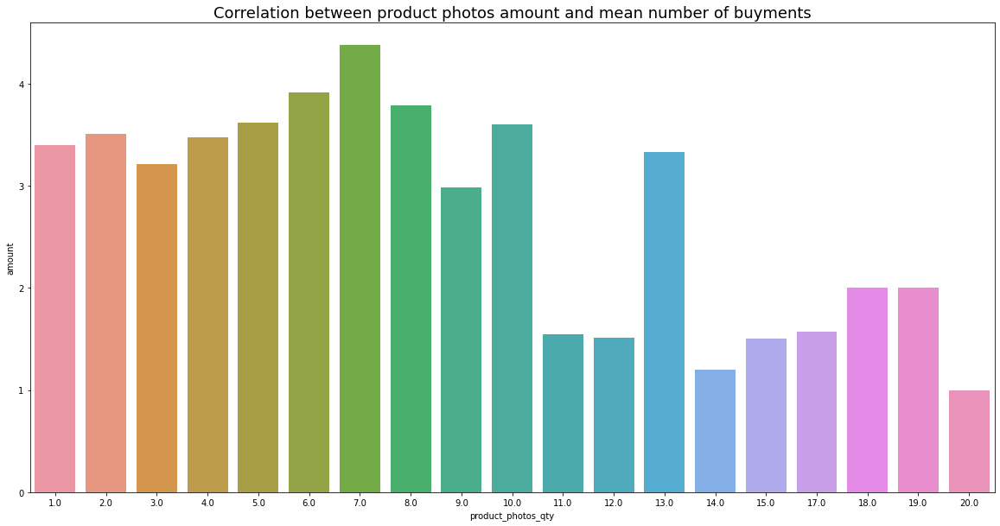

In [ ]:
purchases = products[["product_photos_qty", "product_description_length", "product_name_length", "product_id"]].merge(order_items[["product_id", "order_id"]], on='product_id', how='inner')

correlations = pd.DataFrame(purchases.value_counts("product_id")).merge(purchases, on='product_id', how='inner').rename({0 : "amount"}, axis=1)
correlations.drop_duplicates("product_id", inplace=True)

photos_qty_cor = correlations.groupby("product_photos_qty").agg({"amount" : "mean"}).reset_index()

plt.figure(figsize=(20, 10))
sns.barplot(data=photos_qty_cor,
            x="product_photos_qty",
            y="amount") 
plt.title("Correlation between product photos amount and mean number of buyments", fontsize=18)
plt.show()

In [ ]:
def aggregate(table, agg_step : int, col : str):
  table["number_of_interval"] = np.zeros(len(table))
  number_of_interval = 1
  c = table.at[0, col] + agg_step
  i = 0
  while i < len(table):
    while i < len(table) and table.at[i, col] <= c:
      table.at[i, "number_of_interval"] = number_of_interval
      if (i + 1 < len(table) and table.at[i + 1, col] > c):
        break
      i += 1
    if (i + 1 <len(table)):
      c = table.at[i + 1, col] + agg_step
    i += 1
    number_of_interval += 1

desc_length_cor = correlations.sort_values(by='product_description_length').reset_index().drop("index", axis=1)

aggregate(desc_length_cor, 20, "product_description_length")

desc_length_cor_grp = desc_length_cor[["number_of_interval", "amount", "product_description_length"]].groupby("number_of_interval").mean().reset_index()

px.bar(desc_length_cor_grp,
       x = "product_description_length",
       y = "amount",
       title= "Correlation between product description length and mean number of buyments")


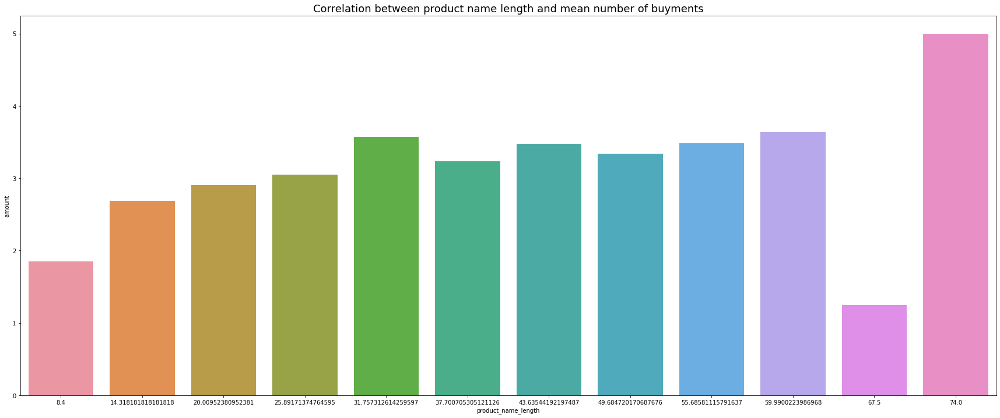

In [ ]:
name_length_cor = correlations.sort_values(by='product_name_length').reset_index().drop("index", axis=1)

aggregate(name_length_cor, 5, "product_name_length")

name_length_cor_grp = name_length_cor[["number_of_interval", "amount", "product_name_length"]].groupby("number_of_interval").mean().reset_index()

plt.figure(figsize=(30, 12))
sns.barplot(data = name_length_cor_grp,
            x = "product_name_length",
            y="amount")
plt.title("Correlation between product name length and mean number of buyments", fontsize=18)
plt.show()

## Задание 5* (1 балл)

Имея полученные данные по товарам, чекам и категориям, а также сделав дополнительные расчеты (если необходимо), предположите:

1. Продавцов каких категорий необходимо привлекать в маркетплейс?

2. Какие категории в каких штатах необходимо развивать?

3. Развитие каких категорий не принесут большого эффекта и почему?

4. Какие рекомендации можно дать для продавцов, чтобы их товар лучше продавался?

## Задание 6 (0.5 балла)

Определите средний чек покупки (добавьте разбивку на стоимость самого заказ и стоимость доставки) и среднее число товаров в заказе

In [ ]:
order_costs = order_items[["order_id", "price", "freight_value"]].groupby("order_id").agg({"price" : "sum", "freight_value" : "sum"}).reset_index()

mean_price = order_costs.price.mean()
mean_freight_value = order_costs.freight_value.mean()

order_items_amounts = order_items[["order_id", "order_item_id"]].groupby("order_id").agg({"order_item_id" : "count"}).reset_index()

mean_amount = order_items_amounts.order_item_id.mean()

print(f"Mean order price: {mean_price}")
print(f"Mean freight value: {mean_freight_value}")
print(f"Mean cost: {mean_price + mean_freight_value}")
print(f"Mean amount of items in an order: {mean_amount}")


Mean order price: 137.7540763788945
Mean freight value: 22.823561713254815
Mean cost: 160.5776380921493
Mean amount of items in an order: 1.1417306873695092


## Задание 7 (0.2 балла)

Определите среднее число покупок на пользователя (обратите внимание на идентификаторы)

In [ ]:
orders_per_customers = orders[["order_id", "customer_id"]].merge(customers[["customer_id", "customer_unique_id"]], on='customer_id', how='inner')

orders_amount_per_customer = orders_per_customers.groupby("customer_unique_id").agg({"order_id" : "count"})

mean_orders_amount_per_customer = float(orders_amount_per_customer.mean())
print(mean_orders_amount_per_customer)


1.0334204550323494


## Задание 8 (0.2 балла)

Отобразите среднюю сумму оплаты по типу оплаты

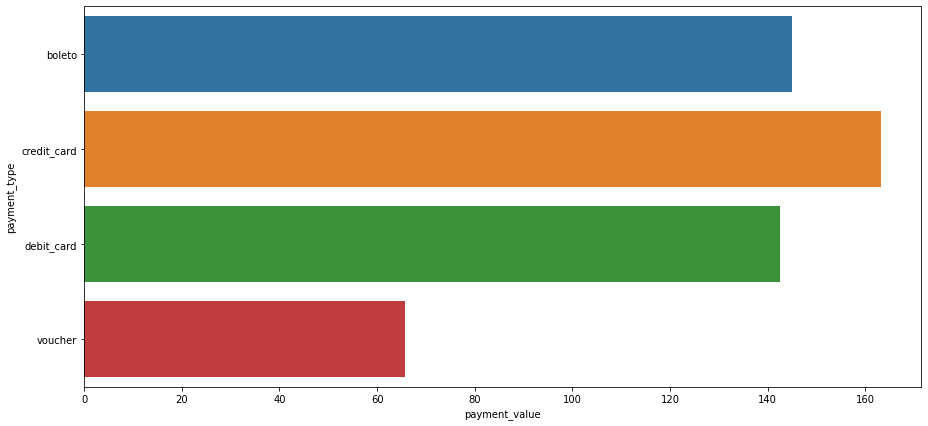

In [ ]:
payment_values_distribution_by_payment_type = payments.groupby("payment_type").agg({"payment_value" : "mean"}).reset_index()

plt.figure(figsize=(15, 7))
sns.barplot(data=payment_values_distribution_by_payment_type,
            x = "payment_value",
            y = "payment_type")

plt.show()


## Задание 9 (0.4 балла)

Обратите внимание на число платежей (payment_installments). Выясните, какая сумма оплаты указана: за целую покупку или только за ее часть?

Также покажите средний чек в зависимости от числа оплаты. Есть ли какая-то связь между ними?

In [ ]:
payments_for_orders = payments.groupby("order_id").agg({"payment_sequential" : "count", "payment_value" : "sum"}).reset_index().rename({"payment_value" : "sum_of_payment_values", 
                                                                                                                                        "payment_sequential" : "amount_of_payments"}, axis=1)

payments_for_orders = payments_for_orders[lambda row: row["amount_of_payments"] > 1]

order_costs = order_items.groupby("order_id").agg({"freight_value" : "sum", "price" : "sum"}).reset_index()
payments_for_orders = payments_for_orders.merge(order_costs[["order_id", "price", "freight_value"]], on='order_id', how='inner')

payments_for_orders["cost_of_order"] = payments_for_orders["price"] + payments_for_orders["freight_value"]
payments_for_orders.drop(["freight_value", "price"], axis=1, inplace=True)
payments_for_orders

,order_id,amount_of_payments,sum_of_payment_values,cost_of_order
0,0016dfedd97fc2950e388d2971d718c7,2,70.55,70.55
1,002f19a65a2ddd70a090297872e6d64e,2,77.29,77.29
2,0071ee2429bc1efdc43aa3e073a5290e,2,192.44,192.44
3,009ac365164f8e06f59d18a08045f6c4,6,32.00,32.00
4,00b4a910f64f24dbcac04fe54088a443,2,50.59,50.59
...,...,...,...,...
2931,ff7400d904161b62b6e830b3988f5cbd,2,154.96,154.96
2932,ff978de32e717acd3b5abe1fb069d2b6,4,49.14,49.14
2933,ffa1dd97810de91a03abd7bd76d2fed1,2,455.31,455.31
2934,ffa39020fe7c8a3e907320e1bec4b985,2,71.14,71.14


Из получившиейся таблицы мы видим, что есть заказы, которые были оплачены несколько раз (amount_of_payments > 1), но при этом суммарно по ним заплачено ровно столько, сколько стоит сам заказ (sum_of_payment_values = cost_of_order). Так как у нас нет нулевых платежей, это значит, что в payment_value указана только часть заказа.

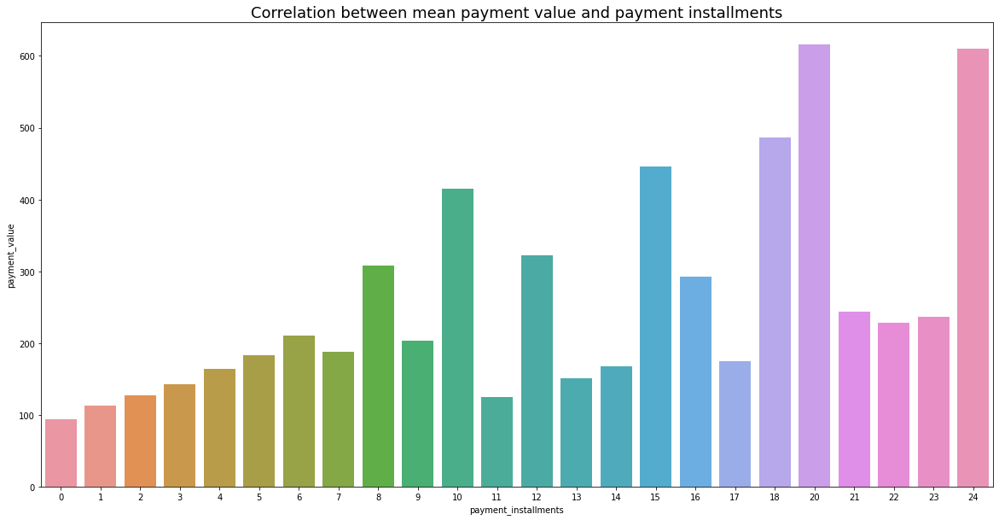

In [ ]:
mean_cost = payments.groupby("payment_installments").agg({"payment_value" : "mean"}).reset_index()

plt.figure(figsize=(20,10))
sns.barplot(data=mean_cost,
            x="payment_installments",
            y="payment_value")
plt.title("Correlation between mean payment value and payment installments", fontsize=18)
plt.show()

Средний чек равномерно возрастает вплоть до 8 платежей и далее начинает колебаться периодически: вплоть до 14 платежей с периодом 1 (т.е. если i-2 значение было больше, чем i-1, то i-1 будет меньше, чем i), а далее -- с периодом 2 или 3. Однако несмотря на эти колебания, видна общая тенденция: в среднем с увеличением числа платежей растёт и средний чек. Это означает, что чем больше стоит товар, тем чаще люди берут его в рассрочку, что логично.

## Задание 10 (0.4 балла)

Визуализируйте зависимость между ценой заказа и ценой доставки по штатам покупки. Есть ли какая-нибудь зависимость и как вы можете ее обосновать?

In [ ]:
order_items_unique = order_items.groupby("order_id").agg({"price" : "sum", "freight_value" : "sum"}).reset_index()
orders_unique = orders.drop_duplicates("order_id")
price_and_freight_value = order_items_unique[["order_id", "price", "freight_value"]].merge(
                              orders_unique[["order_id", "customer_id"]], on='order_id', how='left').merge(
                              customers[["customer_id", "customer_state"]], on='customer_id',how='left'
    )

cols = price_and_freight_value["customer_state"].unique()

fig = go.Figure()

for col in cols:
    price_and_freight_value_in_state = price_and_freight_value[price_and_freight_value["customer_state"] == col].groupby("price").mean().reset_index()
    price_and_freight_value_in_state.sort_values(by="price", inplace=True)
    fig.add_trace(
        go.Scatter(x=price_and_freight_value_in_state["price"],
                   y=price_and_freight_value_in_state["freight_value"], 
                   mode = 'markers',
                   visible=True,
                   opacity=0.6))

buttons = []
updatemenu = [dict()]

for i, col in enumerate(cols):
    visibles = [False] * len(cols)
    visibles[i] = True
    buttons.append(dict(method='restyle',
                        label=col,
                        args=["visible", visibles]
                        ))

updatemenu[0]['buttons'] = buttons
updatemenu[0]['direction'] = 'down'
updatemenu[0]['showactive'] = True

fig.update_layout(showlegend=False, updatemenus=updatemenu)
fig.update_layout(
    title={
        "text": "Correlation between order price and freight value by states",
        "x": 0.5, 
        "font": {"size" : 18}
    }, 
    xaxis_title = 'order price',
    yaxis_title = 'freight value')

fig.show()

Почти во всех штатах мы наблюдаем общую тенденцию: для маленьких заначений цены заказа цена доставки тоже достаточно мала. Однако с возрастанием цены заказа цена доставки увеличивается до своего предельного значения, а далее начинает убывать. Я думаю, что таким образом продавцы стимулируют покупателей приобретать больше (например, с помощью акций в духе "При заказе на более чем 1500 реалов цена доставки уменьшается вдвое").

## Задание 11 (0.4 балла)

Выведите график по числу покупок (в разбивке по статусам) и временем покупки (аггрегируйте покупки до дня)

## Задание 12* (1 балл)

Используя полученные данные, а также сделав дополнительные вычисления (если необходимо), предположите:

1. Есть ли сезонность в покупках на маркетплейсе?

2. Есть ли какие-то необъяснимые падение/рост продаж? С чем это может быть связано?

## Задание 13 (0.3 балла)

Посчитайте CSAT (customer satisfaction - средняя оценка ревью) и отобразите средний CSAT по дням



CSAT: 4.08642062404257


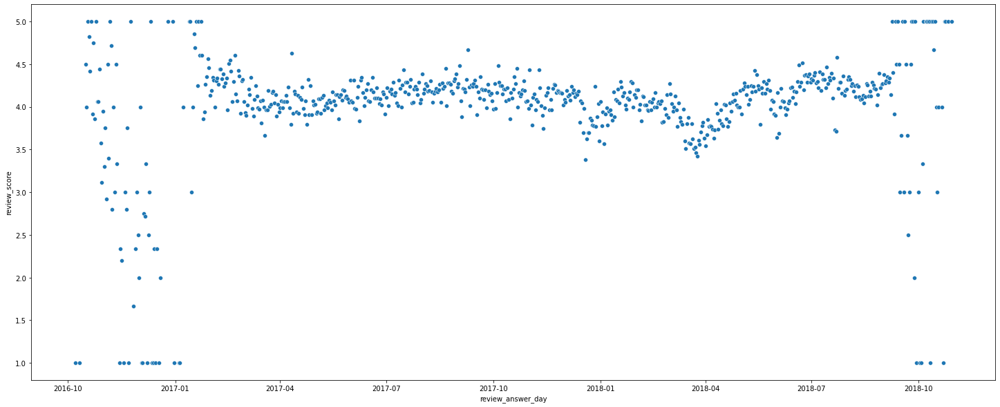

In [ ]:
csat = order_reviews["review_score"].mean()
print(f"CSAT: {csat}")

order_reviews.sort_values(by="review_answer_timestamp", inplace=True)
days = order_reviews["review_answer_timestamp"].unique()

reviews = deepcopy(order_reviews)
reviews["review_answer_day"] = reviews["review_answer_timestamp"].apply(lambda date: datetime.date(int(date[:4]),int(date[5:7]),int(date[8:10])))

reviews_by_days = reviews.groupby("review_answer_day").agg({"review_score" : "mean"}).reset_index()

plt.figure(figsize=(25, 10))
sns.scatterplot(data=reviews_by_days,
            x ="review_answer_day",
            y="review_score")

plt.show()


## Задание 14 (0.3 балла)

Найдите топ-5 лучших и топ-5 худших продавцов по средней оценке и посчитайте их число продаж

In [ ]:
reviews_and_sellers = order_reviews[["order_id", "review_score"]].merge(order_items[["seller_id", "order_id"]], on='order_id', how='inner')
reviews_and_sellers_grp = reviews_and_sellers.groupby("seller_id").agg({"review_score" : "mean"}).reset_index()
reviews_and_sellers_grp = reviews_and_sellers_grp.sort_values(by='review_score').reset_index().drop("index",axis=1)

sellers_and_sales = deepcopy(order_items)
amount_of_sales = pd.DataFrame(sellers_and_sales["seller_id"].value_counts()).reset_index().rename({"seller_id" : "amount_of_sales", "index" : "seller_id"}, axis=1)
amount_of_sales.sort_values("amount_of_sales", inplace=True, ascending=False)

amount_of_sales = amount_of_sales.merge(reviews_and_sellers_grp, on='seller_id', how='inner')

amount_of_sales["in_best"] = amount_of_sales["review_score"].apply(lambda x: x == 5)
amount_of_sales_for_best = amount_of_sales[amount_of_sales["in_best"]].drop("in_best", axis=1)
amount_of_sales_for_best.head()


,seller_id,amount_of_sales,review_score
624,48efc9d94a9834137efd9ea76b065a38,34,5.0
977,a08692680c77d30a0b4280da5df01c5a,17,5.0
1033,0b36063d5818f81ccb94b54adfaebbf5,15,5.0
1156,c8c1bea22194a4eefa2dc9a9fa89f536,13,5.0
1201,404e1ba01358af4cd63f679b2c4d1fa1,12,5.0


In [ ]:
amount_of_sales["in_worst"] = amount_of_sales["review_score"].apply(lambda x: x == 1)
amount_of_sales_for_worst = amount_of_sales[amount_of_sales["in_worst"]].drop("in_worst", axis=1)
amount_of_sales_for_worst.tail()

,seller_id,amount_of_sales,review_score,in_best
3050,3a52d63a8f9daf5a28f3626d7eb9bd28,1,1.0,False
3053,1fddcb7b326905d3ad5efe82187db347,1,1.0,False
3057,3338e7a0710a195872be80e0d2423867,1,1.0,False
3070,ac137bac82ffa8548e62bd9d01d2a14f,1,1.0,False
3086,f3055483058c84d75ca2a3314fb4deef,1,1.0,False


**Пояснение:** поскольку в задании не сказано, как именно определять этих ТОП-5 продавцов (продавцов с оценкой 5 очень много, так же как и продавцов с оценкой 1), я для ТОП-5 лучших вывела продавцов, у которых оценка 5 и наибольшее количество продаж, а для ТОП-5 худших - продавцов, у которых оценка 1 и наименьшее количество продаж

## Задание 15 (0.3 балла)

Посмотрите, как быстро отвечают пользователи (сделайте аггреграцию по дням) и влияет ли это на оценку?

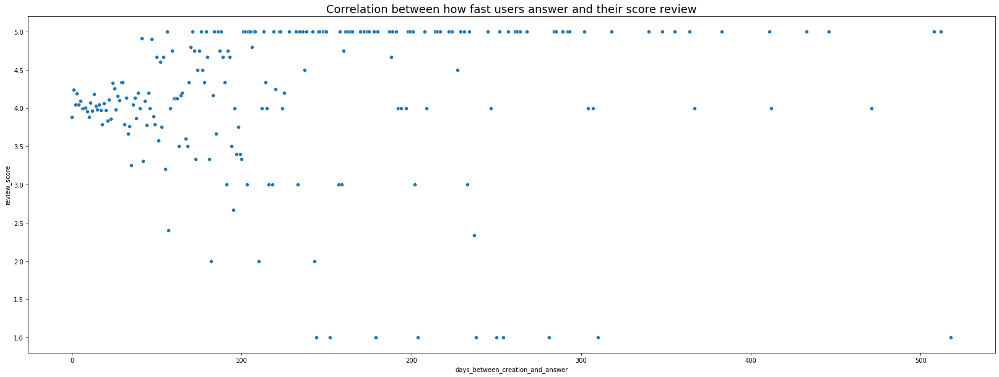

In [ ]:
reviews["review_answer_day"] = reviews["review_answer_timestamp"].apply(lambda date: datetime.datetime(int(date[:4]),int(date[5:7]),int(date[8:10]),int(date[11:13]), int(date[14:16]), int(date[17:19])))
reviews["review_creation_day"] = reviews["review_creation_date"].apply(lambda date: datetime.datetime(int(date[:4]),int(date[5:7]),int(date[8:10]),int(date[11:13]), int(date[14:16]), int(date[17:19])))

reviews["days_between_creation_and_answer"] = (reviews["review_answer_day"] - reviews["review_creation_day"]).apply(lambda x: int(str(x)[:len(str(x)) - 14]))

days_between_and_CSAT = reviews.groupby("days_between_creation_and_answer").agg({"review_score" : "mean"}).reset_index()
days_between_and_CSAT.sort_values(by='days_between_creation_and_answer', inplace=True)

plt.figure(figsize=(28, 10))
sns.scatterplot(data=days_between_and_CSAT, 
            x="days_between_creation_and_answer",
            y="review_score")
plt.title("Correlation between how fast users answer and their score review", fontsize=18)
plt.show()


Мы видим, что если пользватели отвечают в пределах ~60, то нет ни одной неудовлетворительной оценки, но при этом нет и ни одной оценки 5 (т.е. все оценки в диапазоне от 3 до 4). С увеличением же числа дней между созданием опроса и ответа, картина становится более разнообразной: появляются отзывы с оценками 1 и 5, но так же и остаются отзывы с более нейтральными оценками.

## Задание 16 (0.5 балла)

Отобразите распределение оценок для заказов, которые были доставлены вовремя и которые пришли с опозданием. Насколько влияет факт опоздания на оценку?

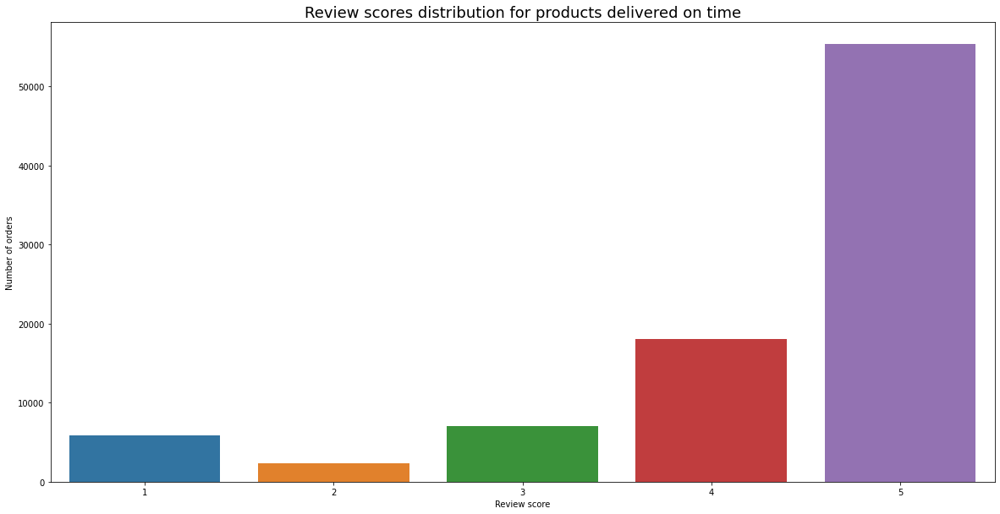

In [ ]:
delivered_orders = (orders[["order_status", "order_delivered_customer_date", "order_estimated_delivery_date", "order_id"]].merge(
    reviews[["review_score", "order_id"]], on="order_id", how="inner"))[lambda row: row["order_status"] == "delivered"]

delivered_orders["delivered_day"] = delivered_orders["order_delivered_customer_date"].apply(lambda date: datetime.datetime(int(str(date)[:4]),int(str(date)[5:7]),int(str(date)[8:10]),int(str(date)[11:13]), int(str(date)[14:16]), int(str(date)[17:19])))
delivered_orders["estimated_day"] = delivered_orders["order_estimated_delivery_date"].apply(lambda date: datetime.datetime(int(str(date)[:4]),int(str(date)[5:7]),int(str(date)[8:10]),int(str(date)[11:13]), int(str(date)[14:16]), int(str(date)[17:19])))

delivered_orders_on_time = delivered_orders[lambda row: row["estimated_day"] >= row["delivered_day"]]
delivered_orders_on_time_grp = delivered_orders_on_time.groupby("review_score").agg({"order_id" : "count"}).reset_index()

delivered_orders_late = delivered_orders[lambda row: row["estimated_day"] < row["delivered_day"]]
delivered_orders_late_grp = delivered_orders_late.groupby("review_score").agg({"order_id" : "count"}).reset_index()

plt.figure(figsize=(20, 10))

bar_on_time = sns.barplot(data=delivered_orders_on_time_grp,
            x='review_score', 
            y='order_id')
bar_on_time.set_xlabel("Review score")
bar_on_time.set_ylabel("Number of orders")
bar_on_time.set_title("Review scores distribution for products delivered on time", fontsize=18)

plt.show()


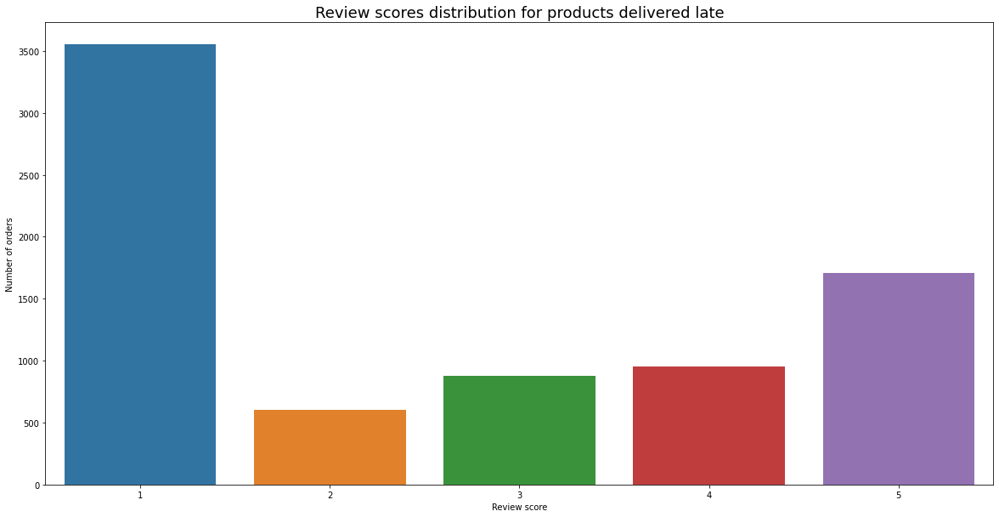

In [ ]:
plt.figure(figsize=(20, 10))

bar_late = sns.barplot(data=delivered_orders_late_grp,
            x='review_score', 
            y='order_id')
bar_late.set_xlabel("Review score")
bar_late.set_ylabel("Number of orders")
bar_late.set_title("Review scores distribution for products delivered late", fontsize=18)

plt.show()

Мы видим, что факт опоздания очень сильно влияет на оценку: среди товаров, доставленных с опозданием, примерно половина товаров имеет отзыв с оценкой 1, в то время как для товаров, доставленных вовремя, ситуация абсолютно противоположна: примерно половина заказов имеют отзыв с оценкой 5.

## Задание 17* (1,5 балла)

Есть ли среди пользователей хейтеры? Определите их и вычислите средний CSAT без их участия

## Задание 18 (0.4 балла)

Изобразите зависимость между ценой заказа и числом дней между покупкой и доставкой с разбивкой по признаку "есть заказ из другого штата". Есть ли зависимость?

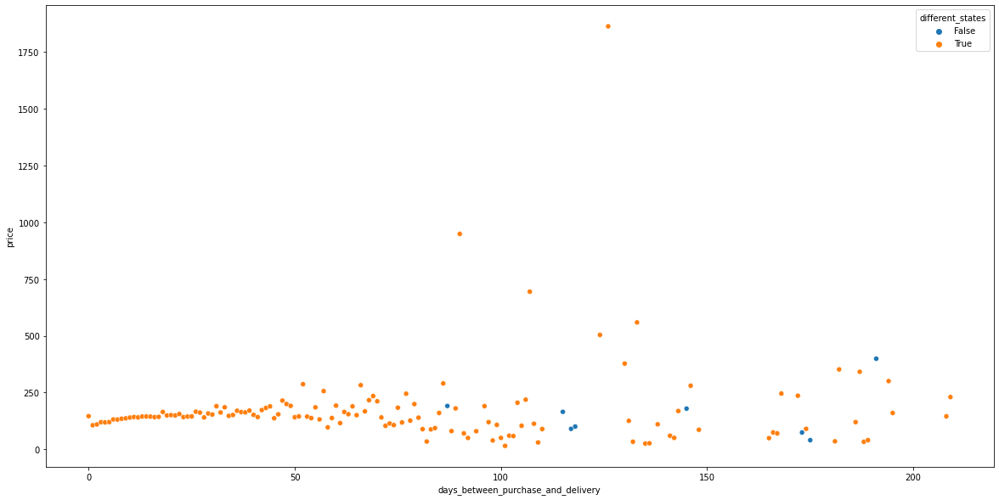

In [ ]:
prices_and_days = orders[["order_id", "customer_id", "order_purchase_timestamp", "order_delivered_customer_date", "order_status"]].merge(
    customers[["customer_id", "customer_state"]], on='customer_id', how='left').merge(
    order_items.groupby("order_id").agg({"price" : "sum"}).reset_index().merge(order_items[["order_id", "seller_id"]], on='order_id', how='left'), on='order_id', how='left').merge(
    sellers[["seller_state", "seller_id"]], on='seller_id', how='left').drop(["seller_id", "customer_id"], axis=1)

prices_and_days.drop_duplicates("order_id", inplace=True)
prices_and_days = prices_and_days[lambda row: row["order_status"] == "delivered"].dropna()
prices_and_days["delivered_day"] = prices_and_days["order_delivered_customer_date"].apply(lambda date: datetime.datetime(int(str(date)[:4]),int(str(date)[5:7]),int(str(date)[8:10]),int(str(date)[11:13]), int(str(date)[14:16]), int(str(date)[17:19])))
prices_and_days["bought_day"] = prices_and_days["order_purchase_timestamp"].apply(lambda date: datetime.datetime(int(str(date)[:4]),int(str(date)[5:7]),int(str(date)[8:10]),int(str(date)[11:13]), int(str(date)[14:16]), int(str(date)[17:19])))
prices_and_days.drop(["order_purchase_timestamp", "order_delivered_customer_date", "order_status"], axis=1, inplace=True)

prices_and_days["days_between_purchase_and_delivery"] = (prices_and_days["delivered_day"] - prices_and_days["bought_day"]).apply(lambda x: int(str(x)[:len(str(x)) - 14]))
prices_and_days["different_states"] = prices_and_days.apply(lambda row: 0 if row["seller_state"] == row["customer_state"] else 1, axis=1)
prices_and_days = prices_and_days.groupby("days_between_purchase_and_delivery").agg({"different_states" : "sum", "price" : "mean"}).reset_index()
prices_and_days["different_states"] = prices_and_days["different_states"].apply(lambda x: x > 0)

plt.figure(figsize=(20, 10))
sns.scatterplot(data=prices_and_days,
                x="days_between_purchase_and_delivery",
                y="price",
                hue="different_states")

plt.show()


Наблюдается общая тенденция: в среднем с увеличением числа дней между покупкой и доставкой цена заказа остаётся неизменной, однако для заказов из других штатов цена доставки обычно выше, чем для заказов из одного штата.

## Задание 19 (0.6 баллов)

Отобразите на карте все точки продавцов (если они находятся в одном месте, то необходимо отметить кол-во)

Где больше всего продавцов находится?

In [ ]:
geolocation.dropna(inplace=True)
sellers_renamed = sellers.rename({"seller_zip_code_prefix" : "geolocation_zip_code_prefix"}, axis=1)
sellers_geolocation = sellers_renamed[["geolocation_zip_code_prefix", "seller_id"]].merge(geolocation[["geolocation_zip_code_prefix", "geolocation_lat", "geolocation_lng", "geolocation_city"]], 
                                                                                          on='geolocation_zip_code_prefix',
                                                                                          how='left')
sellers_geolocation.drop_duplicates("seller_id", inplace=True)

sellers_amount = sellers_geolocation.groupby(["geolocation_lat", "geolocation_lng"]).agg({"seller_id":"count"}).rename({"seller_id" : "amount"}, axis=1)
sellers_geolocation = sellers_geolocation.merge(sellers_amount, on=['geolocation_lat', 'geolocation_lng'], how='inner')


In [ ]:
fig = go.Figure(go.Scattermapbox(lat=sellers_geolocation['geolocation_lat'], lon=sellers_geolocation['geolocation_lng'], text=sellers_geolocation['amount']))

center = sellers_geolocation[sellers_geolocation['geolocation_city']=='goiânia']
map_center = go.layout.mapbox.Center(lat=center['geolocation_lat'].values[0], lon=center['geolocation_lng'].values[0])

fig.update_layout(mapbox_style="open-street-map", mapbox=dict(center=map_center, zoom=3))

fig.show()

Больше всего продавцов находится на юго-востоке Бразилии. Это неудивительно, ведь именно этот регион является наиболее экономически развитым.

## Задание 20 (1,5 балл)

Определите топ-5 продавцов, которые чаще всего отсылают свою посылку в другие регионы и визуализируйте их отсылки

In [ ]:
sellers_to_different_states = orders[["order_id", "customer_id"]].merge(
    customers[["customer_id", "customer_state"]], on='customer_id', how='inner').merge(
    order_items[["order_id", "seller_id"]], on='order_id', how='inner').merge(
    sellers[["seller_state", "seller_id"]], on='seller_id', how='inner').drop("customer_id", axis=1)
    
sellers_to_different_states["diff"] = sellers_to_different_states.apply(lambda row: 1 if row["customer_state"] != row["seller_state"] else 0, axis=1)

top_five = (sellers_to_different_states.groupby("seller_id").agg({"diff" : "sum"}).reset_index().sort_values("diff", ascending=False).rename({"diff" : "amount"}, axis=1))[:5]
top_five

,seller_id,amount
358,1f50f920176fa81dab994f9023523100,1249
1190,6560211a19b47992c3666cc44a7e94c0,1116
858,4a3ca9315b744ce9f8e9374361493884,1071
2388,cc419e0650a3c5ba77189a1882b7556a,1042
188,1025f0e2d44d7041d6cf58b6550e0bfa,918


In [ ]:
top_five_to_diff_states = (sellers_to_different_states.merge(top_five, on='seller_id', how='right'))[lambda row: row["diff"] == 1]
top_five_to_diff_states = top_five_to_diff_states.merge(orders[["order_id", "customer_id"]], on='order_id', how='left') 

customers_renamed = customers.rename({"customer_zip_code_prefix" : "geolocation_zip_code_prefix"}, axis=1)
customers_geolocation = customers_renamed.merge(
    geolocation[["geolocation_zip_code_prefix", "geolocation_lat", "geolocation_lng"]], on='geolocation_zip_code_prefix', how='inner').merge(
    orders[["customer_id", "order_id"]], on='customer_id', how='left').merge(
    order_items[["seller_id", "order_id"]], on='order_id', how='left').drop(
    ["geolocation_zip_code_prefix", "customer_city", "customer_state", "order_id"], axis=1)

In [ ]:
fig = make_subplots(rows=3, cols=2, 
    specs=[[{'type': 'mapbox'}, {'type': 'mapbox'}], [{'type': 'mapbox'}, {'type': 'mapbox'}], [{'type': 'mapbox'}, {}]])

top_five_sellers = top_five["seller_id"]

h = 0
v = 1

for i, seller in enumerate(top_five_sellers):
  if i % 2 == 0:
    h += 1
  v = (i % 2) + 1
  seller_to_diff_states = top_five_to_diff_states[lambda row: row["seller_id"] == seller]
  seller_customers = customers_geolocation[lambda row: row["seller_id"] == seller]
  seller_customers_amount = seller_customers.groupby(["geolocation_lat", "geolocation_lng"]).agg({"customer_id":"count"}).rename({"customer_id" : "amount"}, axis=1).reset_index()
  fig.add_trace(go.Scattermapbox(
      lat=seller_customers_amount['geolocation_lat'], 
      lon=seller_customers_amount['geolocation_lng'],
      text=seller_customers_amount['amount'],
      name=f"{i + 1} seller: {seller}"), h, v)
  

center = sellers_geolocation[sellers_geolocation['geolocation_city']=='goiânia']
map_center = go.layout.mapbox.Center(lat=center['geolocation_lat'].values[0], lon=center['geolocation_lng'].values[0])

fig.update_mapboxes(style='open-street-map', center=map_center, zoom=2.7)

fig.update_layout(
    title={
        "text": "Top five sellers and their sendings",
        "x" : 0.5
    },
    width=1600, 
    height=2500)

fig.show()

## Задание 21* (2 балла)

Сделайте анимацию по датам с доставкой между продавцами и пользователями

## Задание 22* (творческое, отдельно поставим баллы)

Проведите дополнительно исследование между параметрами, которые вам интересны и могут быть полезными (обоснуйте, зачем это смотреть). Сделайте выводы

## Попугай для ДЗ

![](https://upload.wikimedia.org/wikipedia/commons/thumb/c/ca/Rose-ringed_parakeet_%28Psittacula_krameri_manillensis%29.jpg/1024px-Rose-ringed_parakeet_%28Psittacula_krameri_manillensis%29.jpg)

А это ожереловый попугай (или индийский кольчатый попугай). Этот вид явно выделяет наличие такого колечка на шее. Самый распространенный попугай в мире

Они очень хорошо и быстро летают, но ходят максимально неуклюже)

В отличии от многих попугаев, для которых человеческая деятельность является вредом и уменьшает их естественный ареал обитания, то как раз для этих птиц человеческая деятельность - это плюс, потому что они находят корм внутри человеческих обществ (не боятся людей, лучше всего приспосабливаются, едят пшеницу). Поговаривают, что в качестве домашних попугаев их держали еще в древней Греции и Риме, а в  средневековой Индии ожереловые попугаи часто были питомцами знатных особ и монархов, причём владение этим попугаем считалось элементом роскоши и престижа